In [1]:
# !pip install git+https://github.com/gaarangoa/samecode.git
# !pip install seaborn
# !pip install scipy
# !pip install scikit-learn
# !pip uninstall samv2 --yes

# Identification of disease in corns using AI
@UmayuxLabs

In [1]:
import matplotlib.pyplot as plt
import numpy as np
import requests
from PIL import Image

In [2]:
from samecode.plot.pyplot import subplots
import seaborn as sns

In [3]:
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.linear_model import LogisticRegression
import pickle

In [4]:
from mazorca.utils import MaskGenerator
from mazorca.utils import MaskFeaturizer
from mazorca.utils import Embedder
from mazorca.utils import PixelPredictor
from mazorca.utils import ObjectPredictor
from mazorca.utils import ObjectCorrector
from mazorca.utils import visualize

In [5]:
from sklearn.pipeline import Pipeline

In [6]:
%load_ext autoreload
%autoreload 2

In [7]:
pipe = Pipeline([
    ('generate_masks', MaskGenerator(model='large')),
    ('extract_features', MaskFeaturizer()),
    ('extract_embeddings', Embedder()),
    ('pixel_predictor', PixelPredictor()),
    ('object_predictor', ObjectPredictor()),
    ('object_correction', ObjectCorrector())
])

In [8]:
# %%time

In [10]:
import os

# Define the path
folder_path = "../results"

# Check if the folder exists; if not, create it
if not os.path.exists(folder_path):
    os.makedirs(folder_path)
    print(f"Folder created at {folder_path}")
else:
    print(f"Folder already exists at {folder_path}")

Folder created at ../results


processing ._1-12.jpg
processing ._1-13.jpg
processing ._1-14.jpg
processing 1-1.jpg
masking image ...
Extract feature ...
getting embeddings ...
pixel prediction ...
Object prediction ...
object box correction and filtering
processing 1-10.jpg
masking image ...
Extract feature ...
getting embeddings ...
pixel prediction ...
Object prediction ...
object box correction and filtering
processing 1-11.jpg
masking image ...
Extract feature ...
getting embeddings ...
pixel prediction ...
Object prediction ...
object box correction and filtering
processing 1-12.jpg
masking image ...
Extract feature ...
getting embeddings ...
pixel prediction ...
Object prediction ...
object box correction and filtering
processing 1-13.jpg
masking image ...
Extract feature ...
getting embeddings ...
pixel prediction ...
Object prediction ...
object box correction and filtering
processing 1-14.jpg
masking image ...
Extract feature ...
processing 1-15.jpg
masking image ...
Extract feature ...
getting embeddings 

/workspaces/AgroZero/code/mazorca/utils.py:266: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  sns.scatterplot(


processing 1-8.jpg
masking image ...
Extract feature ...
getting embeddings ...
pixel prediction ...
Object prediction ...
object box correction and filtering
processing 1-9.jpg
masking image ...
Extract feature ...
getting embeddings ...
pixel prediction ...
Object prediction ...
object box correction and filtering


OSError: Cannot save file into a non-existent directory: '../results'

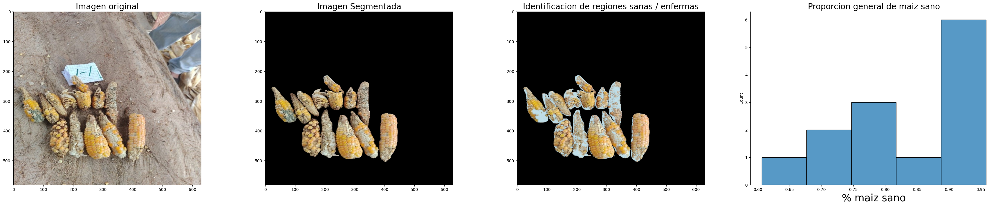

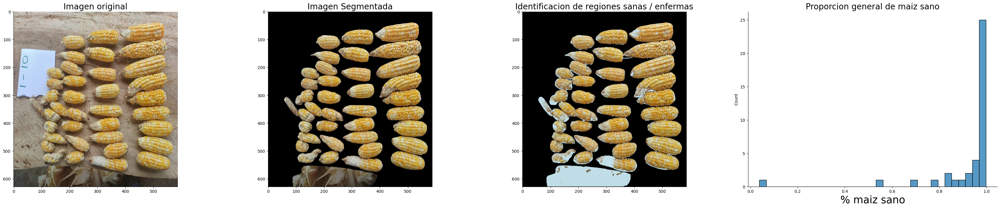

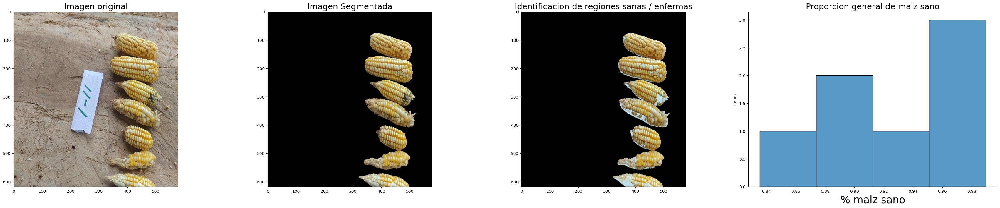

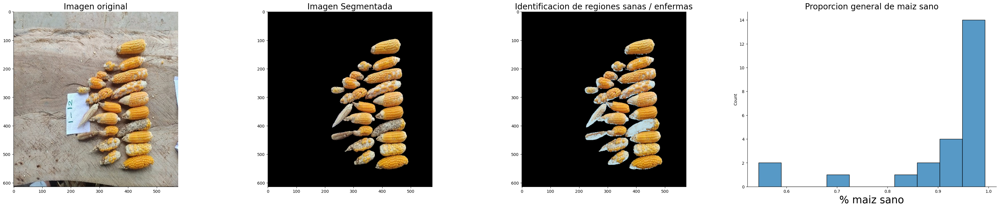

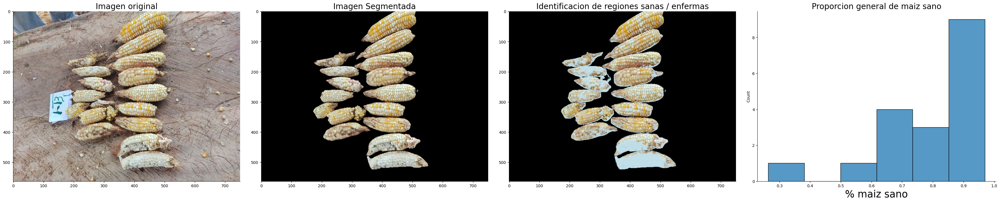

...

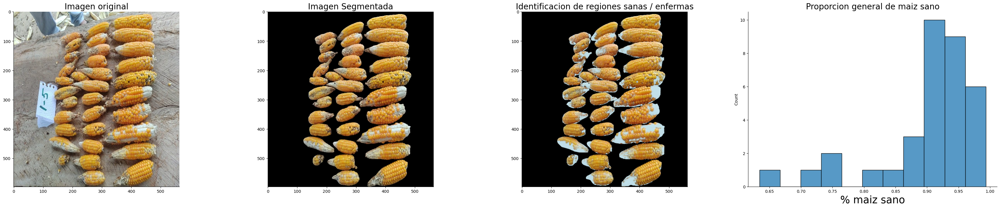

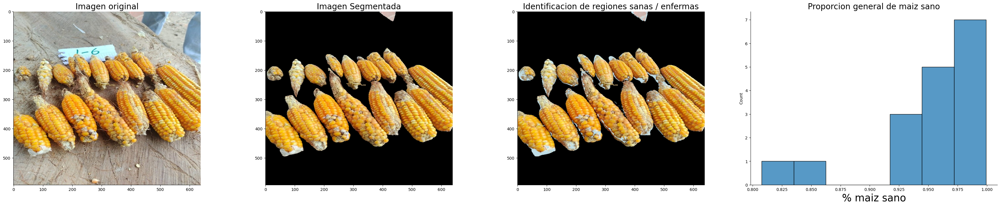

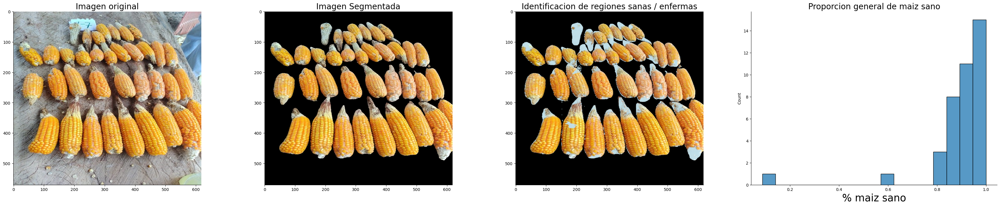

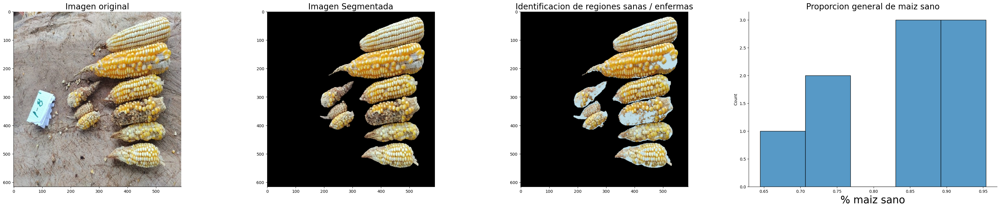

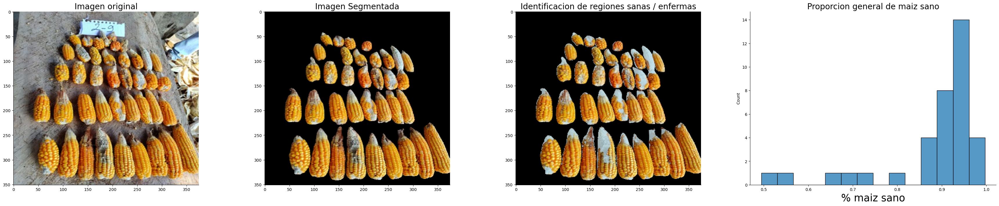

In [9]:
stats = []
for ifile in os.listdir('../data/'):
    print('processing {}'.format(ifile))
    try:
        image = Image.open('../data/{}'.format(ifile))
        image = np.array(image.convert("RGB"))
        
        objects = pipe.transform(image);
        
        f = visualize(image, objects)
        f.savefig('../results/{}.png'.format(ifile), dpi=128)
        for obj in objects:
            stats.append({
                "lote": ifile, 
                "index": obj['index'],
                "corn_disease_percent": obj['corn_disease_percent']
            })
    except:
        pass
        
stats = pd.DataFrame(stats)
stats.to_csv('../results/stats.csv', index=False)

In [12]:
order = stats.groupby('lote').median().reset_index().sort_values('corn_disease_percent').lote.values
sns.boxplot(data=stats, y='lote', x='corn_disease_percent', order=order)
sns.despine()

KeyError: 'lote'